# <div align="center">**Sentinel image processing and analysis**</div>

In [1]:
pip install sentinelsat

Note: you may need to restart the kernel to use updated packages.


In [2]:
%%time
from sentinelsat import SentinelAPI, read_geojson, geojson_to_wkt;
import getpass;
import zipfile;
#url = 'https://dhr1.cesnet.cz/'; api = SentinelAPI(input("User name for " + url), getpass.getpass(), url);
#image = api.download('7e35d7b1-5d60-4590-a41b-28cddb837f2d');
#zipfile.ZipFile(image["path"]).extractall('')

CPU times: user 88.4 ms, sys: 24.1 ms, total: 112 ms
Wall time: 121 ms


In [3]:
import rasterio
import rasterio.plot as plot
from rasterio.plot import show

### <div align="center">**Loading image from downloaded data**</div>

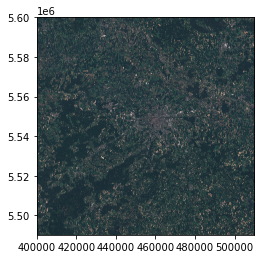

CPU times: user 6min 6s, sys: 1min 14s, total: 7min 20s
Wall time: 3min 45s


<AxesSubplot:>

In [4]:
%%time
image_path = "S2B_MSIL1C_20210617T100559_N0300_R022_T33UVR_20210617T121634.SAFE/GRANULE/L1C_T33UVR_A022356_20210617T101301/IMG_DATA/"
tci = rasterio.open(image_path + 'T33UVR_20210617T100559_TCI.jp2', driver='JP2OpenJPEG');
show(tci)

#### <div align="center">**Position of selected image in OpenStreet Maps**</div>

In [5]:
import folium
from rasterio import warp
from use_functions import reverse_coordinates, to_index, generate_polygon, pol_to_np, pol_to_bounding_box

In [6]:
# original bounds of the image
bounds_trans_original = warp.transform_bounds(tci.crs,{'init': 'epsg:4326'},
                                              *tci.bounds)
polygon_trans_original = generate_polygon(bounds_trans_original)

polyline_polygon_trans_original = folium.PolyLine(reverse_coordinates(polygon_trans_original),
                                                  popup="polygon_trans_original",
                                                  color="green")#"#2ca02c")

In [7]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb

#### Image was taken on the 17th of June 2021 and represents aprox. 100 x 100 km area over the Central Bohemia. We can now choose area of interest, in this case let's choose **Prague**. 

In [8]:
import geojson

# Open geojson file with GPS coordinates
with open("geojson/map.geojson") as f:
    gj = geojson.load(f)

# Load coordinates from geojson file
coor = gj['features'][0]['geometry']['coordinates']

k = 0
cord = [[0] for i in range(len(coor[0]))]
for i in range(len(coor)):
    for j in range(len(coor[0])):
        cord[k] = coor[i][j]
        k += 1

In [9]:
polyline_pol_clip = folium.PolyLine(reverse_coordinates(cord), popup="cord",color="red")

In [10]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
map_bb

In [11]:
from bbox_converter import bbox_converter
bbox_converter("geojson/map.geojson","geojson/prague_bbox_test.geojson",32633)

The file geojson/prague_bbox_test.geojson has been saved!


In [12]:
import geopandas as gpd
gdf = gpd.read_file("geojson/prague_bbox_test.geojson")

#### Prague area on the Sentinel image

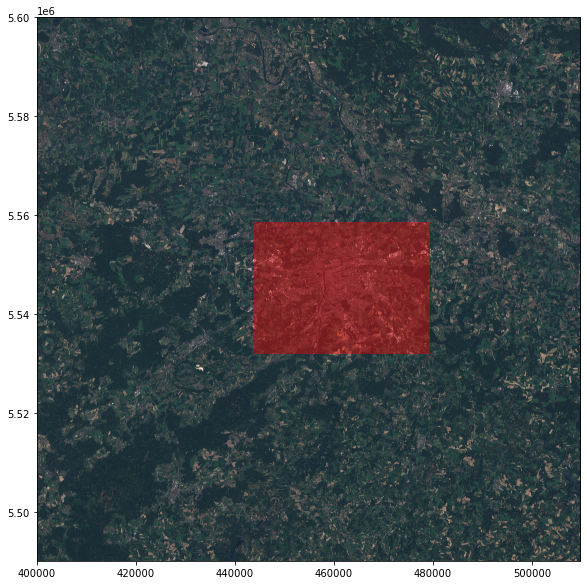

CPU times: user 6min 13s, sys: 1min 16s, total: 7min 29s
Wall time: 3min 52s


In [13]:
%%time
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 10))
show(tci,ax=ax)
gdf.plot(ax=ax, color='red', alpha=.4, aspect=1)
plt.show()

### <div align="center">**Insert clipped Sentinel image in OpenStreet Map**</div>

In [14]:
import numpy as np
from rasterio import windows

clipped_img = rasterio.open('Prague_sunny/rotated/TCI.tif')
# Read img and convert to numpy stack
img = np.stack([clipped_img.read(i) for i in range(1,4)], 
               axis=-1)

In [15]:
bbox = pol_to_bounding_box(cord)
bounds_trans = warp.transform_bounds({'init': 'epsg:4326'},clipped_img.crs,*bbox)
pol_bounds_trans = generate_polygon(bounds_trans)

bbox = pol_to_bounding_box(pol_bounds_trans)
window_same = windows.from_bounds(*bbox,clipped_img.transform)
transform_window = windows.transform(window_same,clipped_img.transform)

In [16]:
transform,width,height = warp.calculate_default_transform(clipped_img.crs, {"init":"epsg:4326"},
                                                          img.shape[1],img.shape[0],
                                                          left=bbox[0],bottom=bbox[1],
                                                          right=bbox[2],top=bbox[3])
                                                          #resolution=0.002)

out_array = np.ndarray((img.shape[2],height,width),dtype=img.dtype)

In [17]:
warp.reproject(np.transpose(img,axes=(2,0,1)),
               out_array,
               src_crs=clipped_img.crs,
               dst_crs={"init":"epsg:4326"},
               src_transform=transform_window,
               dst_transform=transform,
               resampling=warp.Resampling.bilinear);

#plt.figure(figsize=(8,8))
#plot.show(out_array, transform=transform)

In [18]:
bbox_clip = pol_to_bounding_box(cord)

mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0

map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)

map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
image_overlay = folium.raster_layers.ImageOverlay(np.transpose(out_array,(1,2,0)),
                                                  [[bbox_clip[1],
                                                    bbox_clip[0]],
                                                   [bbox_clip[3],
                                                    bbox_clip[2]]])
map_bb.add_child(image_overlay)
map_bb

## <div align="center">**Sentinel image analysis**</div>

### Once we have cropped and resampled raw images in order to get our area of interest, we can display and process them.

In [19]:
from image_functions import load_sentinel_image, display_rgb, plot_masked_rgb, normalized_difference, image_rgb
from matplotlib import pyplot as plt
import numpy as np

Here one can choose three Sentinel bands and combine them in "RGB" image. Depending on position of each band in RGB image results in different color of the overall image.

In [20]:
img_rgb = load_sentinel_image("Prague_sunny/", ["B02", "B03", "B04"])
img_nir = load_sentinel_image("Prague_sunny_resample/", ["B03", "B04", "B06"])

rgb = image_rgb(img_rgb, 'B04', 'B03', 'B02', alpha=5.)
nir = image_rgb(img_nir, 'B06', 'B04', 'B03', alpha=5.)

#### We can compute spectral index using different bands. In this notebook we calculate Normalized Difference (ND) index using custom function. ND index is defined as:

$$ ND = (Band1 - Band2)/ (Band1 + Band2) $$

#### Here we calculate two indexes, where different areas are emphasized.

In [21]:
img_nir2 = load_sentinel_image("Prague_sunny_resample/", ["B03", "B04", "B05"])

# Calculating two indices
ndvi = normalized_difference(img_nir2, 'B05', 'B04')
mndwi = normalized_difference(img_nir2, 'B03', 'B05')

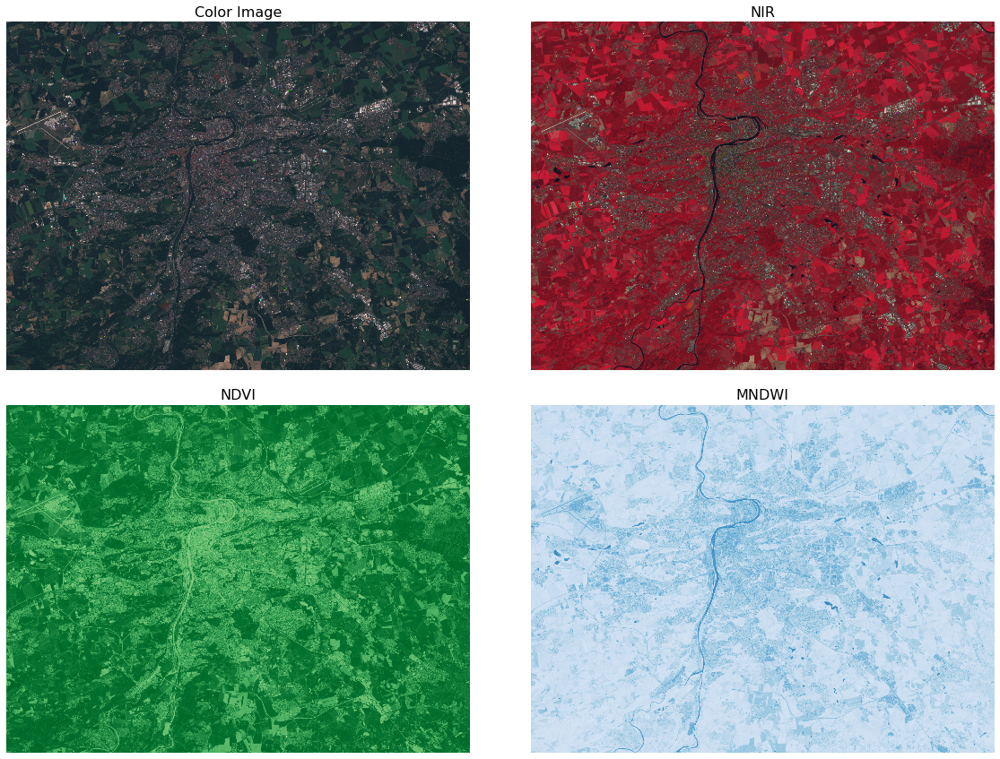

In [22]:
from matplotlib import pyplot as plt
# checking the images
fig, ax = plt.subplots(2, 2, figsize=(20, 15))

fontsize=16
ax = ax.flatten()

ax[0].imshow((rgb*255).astype(np.uint8), interpolation='none')
ax[0].axis('off')
ax[0].set_title('Color Image', fontsize=fontsize)

ax[1].imshow((nir*255).astype(np.uint8), interpolation='none')
ax[1].axis('off')
ax[1].set_title('NIR', fontsize=fontsize)

ax[2].imshow(ndvi, cmap='Greens', interpolation='none')
ax[2].axis('off')
ax[2].set_title('NDVI', fontsize=fontsize)

ax[3].imshow(mndwi, cmap='Blues', interpolation='none') # * 255).astype(np.uint8)
ax[3].axis('off')
ax[3].set_title('MNDWI', fontsize=fontsize)

plt.subplots_adjust(wspace=0.1, hspace=0.1)

plt.show()

Color image is a true color image, what one can observe for example from a plane. NIR image is more sensitive to different kind of vegetation and water areas. NDVI index gives a better response (higher values = greener because of the colormap we applied) over the vegetation areas and the MNDWI has a higher response (higher values = bluer because of the ‘Blues’ colormap) for water areas like rivers.

#### We can create mask for water areas using MNDWI index. Setting treshold for this index we can display only pixels with higher value representing water area and zero value for the rest.

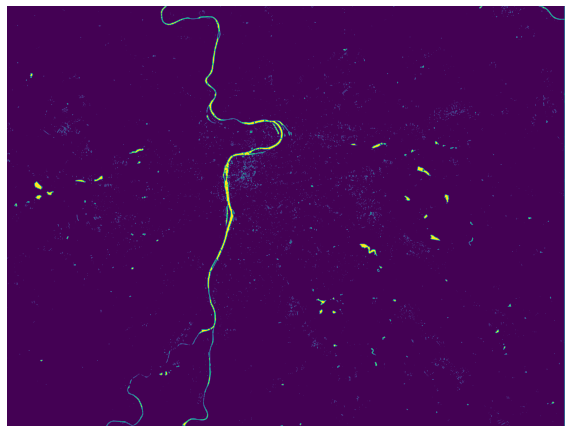

In [23]:
water_mask = mndwi > 0.05

plt.figure(figsize=(10,10))
plt.imshow(water_mask)
plt.axis("off")
plt.show()

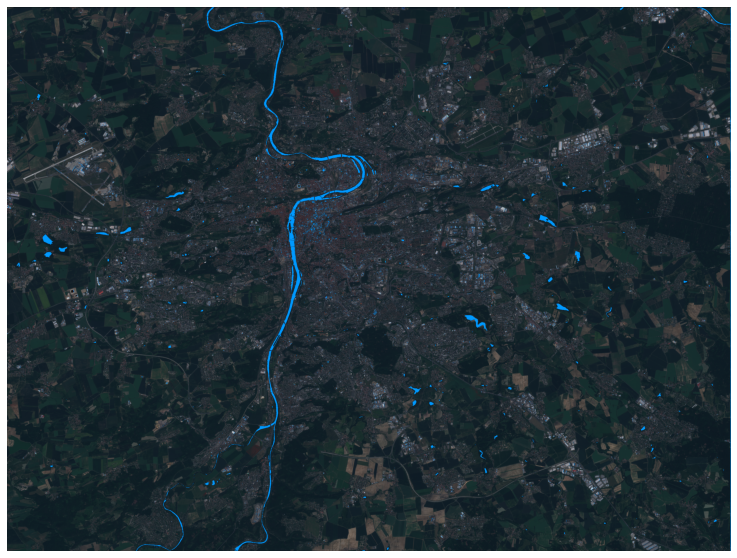

In [24]:
mask = water_mask
shape = img_rgb['B02'].shape
mask = mask[:shape[0], :shape[1]]

mask = np.where(img_rgb['B02'] == 0, 0, mask)

masked_rgb = plot_masked_rgb(red=img_rgb['B04'],
                             green=img_rgb['B03'],
                             blue=img_rgb['B02'],
                             mask=mask,
                             color_mask=(0, 0.6, 1),
                             transparency=0.0,
                             brightness=3.5
                            )

plt.figure(figsize=(15, 10))
plt.imshow((masked_rgb * 255).astype(np.uint8))
plt.axis("off")
plt.show()

#### Displaying water mask over true color image we end up with a nice illustration of the river Vltava and surronding water areas in Prague.  

#### We can play more with the bands and their order while displaying.

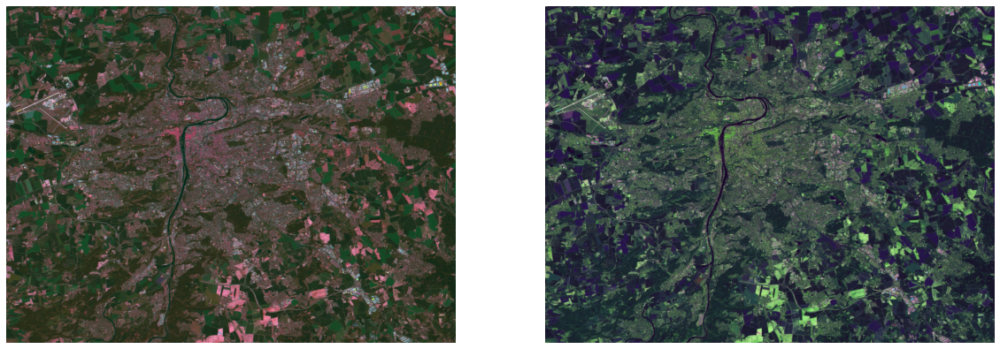

In [25]:
img = load_sentinel_image("Prague_sunny_resample/", ["B03", "B04", "B12"])
rgb = image_rgb(img, 'B12', 'B03', 'B04', alpha=6.)
bgr = image_rgb(img, 'B04', 'B12', 'B03', alpha=6.)

fig, ax = plt.subplots(1, 2, figsize=(20, 15))
ax[0].imshow((rgb* 255).astype(np.uint8), cmap='Greens')
ax[0].axis('off')
ax[1].imshow((bgr* 255).astype(np.uint8), cmap='Blues')
ax[1].axis('off')
plt.show()

#### Here is the same image (same bands) but in different order creating different color labeling of the same areas.

#### Choosing different bands and their order, we can distinguish different areas in Sentinel images.

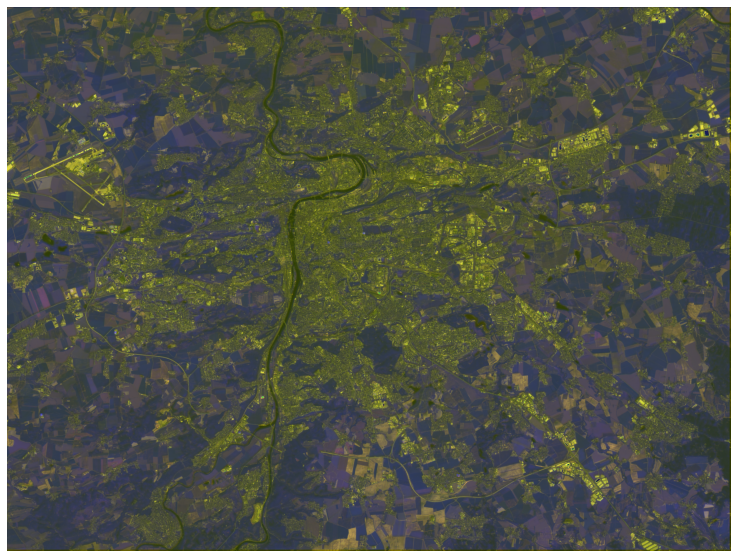

In [26]:
img = load_sentinel_image("Prague_sunny_resample/", ["B02", "B03", "B09"])
display_rgb(img, 'B03', 'B02', 'B09', alpha=6.,figsize=(15, 10))

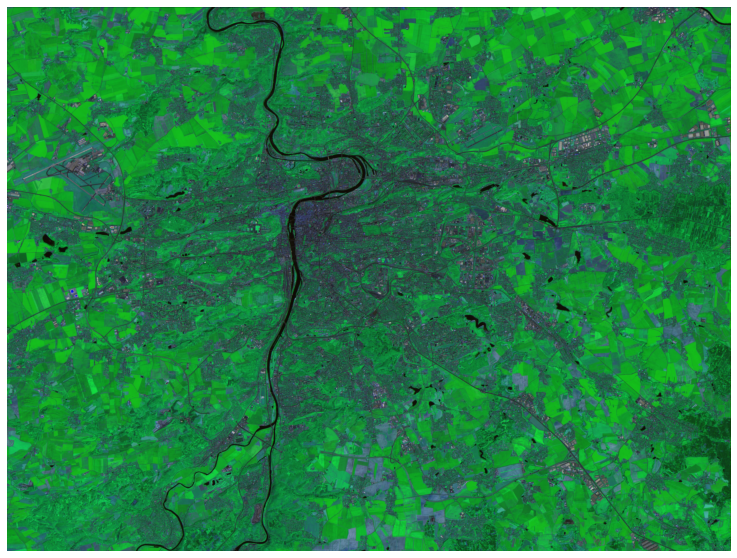

In [27]:
img = load_sentinel_image("Prague_sunny_resample/", ["B04", "B08", "B11"])
display_rgb(img, 'B04', 'B08', 'B11', alpha=3.5,figsize=(15, 10))

### We can narrow down our analysis strictly within Prague boundaries

In [28]:
from coordinates_converter import coor_converter
coor_converter("geojson/prague.geojson","geojson/prague_GPScut.geojson",32633)

The file geojson/prague_GPScut.geojson has been saved!


In [29]:
import geopandas as gpd
import rasterio
from rasterio.plot import show

gdf = gpd.read_file("geojson/prague_GPScut.geojson")

rgb_tci = rasterio.open("Prague_sunny/TCI.tif")

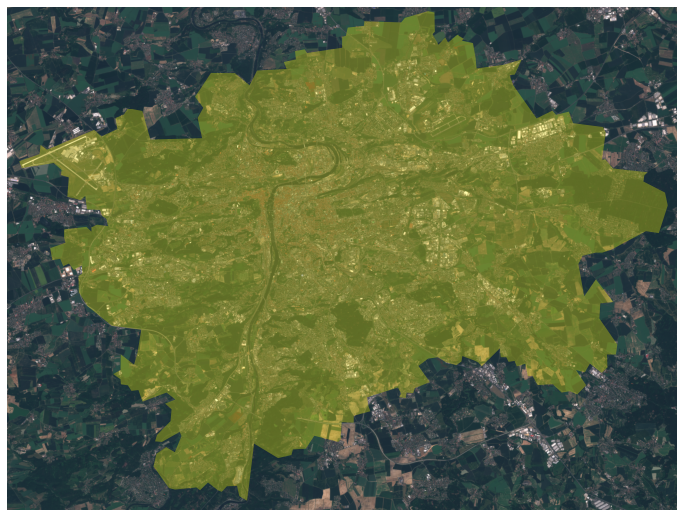

In [30]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 10))
show(rgb_tci,ax=ax)
gdf.plot(ax=ax, color='yellow', alpha=.3, aspect=1)
plt.axis("off")
plt.show()

### We can look for parks or buildings in Prague area

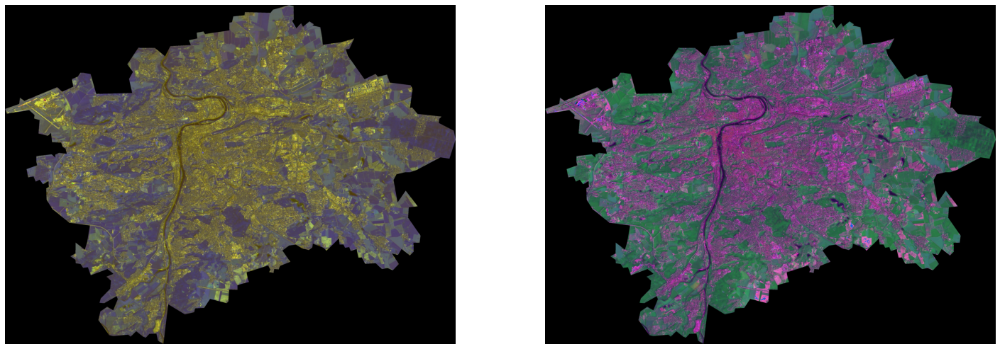

In [31]:
img = load_sentinel_image("Prague_sunny_resample/clipped/", ["B02", "B03", "B09"])
img1 = load_sentinel_image("Prague_sunny_resample/clipped/", ["B03", "B04", "B09"])
rgb = image_rgb(img, 'B02', 'B03', 'B09', alpha=7.5)
bgr = image_rgb(img1, 'B04', 'B09', 'B03', alpha=8.5)

fig, ax = plt.subplots(1, 2, figsize=(25, 20))
ax[0].imshow((rgb* 255).astype(np.uint8))
ax[0].axis('off')
ax[1].imshow((bgr* 255).astype(np.uint8))
ax[1].axis('off')
plt.show()